# Gerando Gráficos

In [18]:
import polars as pl
import json
import plotly.express as px

In [19]:
df = pl.read_parquet("../data/gold/PNAD_COVID_092020_112020.parquet")
df.shape

(1149197, 51)

In [20]:
def bargraph(aux, x, y, titulo, subtitulo, x_label, y_label):
    
    fig = px.bar(aux, 
               x=x,
               y=y,
               width=800, 
               height=400
              )
    
    fig.update_traces(opacity=0.7)
    
    fig.update_layout(
        title_text=f"<b>{titulo}</b><br /><span style='font-size: 13px; color: #666;'>{subtitulo}</span>",
        xaxis_title_text=f'{x_label}',
        yaxis_title_text=f'{y_label}',
        bargap=0.1,
        title_font=dict(size=18, color='#444'),
        title_xanchor = 'center',
        title_x = 0.5,
        title_y = .9,
        margin=dict(l=50, r=50, t=100, b=50),
        uniformtext_minsize=8,
        uniformtext_mode='hide',
        yaxis_range=[0, aux[y].max()+100]
    )
    
    fig.update_xaxes(
        title_font=dict(size=14, color='#666')
    )
    
    fig.update_yaxes(
        title_font=dict(size=14, color='#666')
    )
    
    fig.update_traces(
        texttemplate='%{y:.1f}%', 
        textposition='outside',
        hovertemplate="<br>".join([
            "<b>%{x}</b>",
            "%{y}%"
        ])
    )
    
    return fig
    

In [21]:
def bargraph_color(aux, x, y, color, titulo, subtitulo, x_label, y_label, legend_label = None, legend_y = None):
    
    fig = px.bar(aux, 
               x=x,
               y=y,
               color = color,
               width=800, 
               height=500
              )
    
    fig.update_traces(opacity=0.7)
    
    fig.update_layout(
        title_text=f"<b>{titulo}</b><br /><span style='font-size: 13px; color: #666;'>{subtitulo}</span>",
        xaxis_title_text=f'{x_label}',
        yaxis_title_text=f'{y_label}',
        bargap=0.1,
        title_font=dict(size=18, color='#444'),
        title_xanchor = 'center',
        title_x = 0.5,
        title_y = .9,
        legend_title_side='top center',
        legend_title_text=legend_label,
        legend=dict(
            orientation="h",
            yanchor="bottom",
            y=-.4 if legend_y is None else legend_y,
            xanchor="center",
            x=0.5
        ),
        margin=dict(l=50, r=50, t=100, b=50),
        uniformtext_minsize=8,
        uniformtext_mode='hide',
        yaxis_range=[0, 110]
    )
    
    fig.update_xaxes(
        title_font=dict(size=14, color='#666')
    )
    
    fig.update_yaxes(
        title_font=dict(size=14, color='#666')
    )
    
    fig.update_traces(
        texttemplate='%{y:.1f}%', 
        textposition='inside',
        hovertemplate="<br>".join([
            "<b>%{x}</b>",
            "%{y}%"
        ])
    )
    
    return fig

In [22]:
def piegraph(aux, values, names, titulo, subtitulo, legend_label):
    
    fig = px.pie(aux, 
             values=values, 
             names=names, 
             color=names, 
             width=500, 
             height=400
            )
    
    fig.update_traces(opacity=0.9)
    
    fig.update_layout(
        title_text=f"<b>{titulo}</b><br /><span style='font-size: 13px; color: #666;'>{subtitulo}</span>",
        title_font=dict(size=18, color='#444'),
        title_xanchor = 'center',
        title_x = 0.5,
        title_y = .93,
        legend_title_side='top center',
        legend_title_text=legend_label,
        legend=dict(
            orientation="h",
            yanchor="bottom",
            y=-.2,
            xanchor="center",
            x=0.5
        ),
        margin=dict(l=50, r=50, t=100, b=50),
        uniformtext_minsize=8,
        uniformtext_mode='hide',
    )
    
    fig.update_traces(
        texttemplate='%{value:.0f}%', 
        textposition='inside',
        hovertemplate="<br>".join([
            "<b>%{label}</b>",
            "%{value}%"
        ])
    )
    
    return fig
    


## Estado

In [6]:
#aux = df.group_by('uf_nome').agg(pl.count('uf').alias('qtd'))
#geo = json.load(open('../data/brazil_geo.json'))
#
#fig = px.choropleth(aux, geojson=geo, locations='uf_nome', color='qtd',
#            scope="south america",labels={'Cases':'Cases'})
#fig.update_layout(title='COVID-19 in Brazil: cases by state', margin={"r":0,"t":0,"l":0,"b":0})
#fig.show()

## Tipo Domicílio

## Histograma Idade

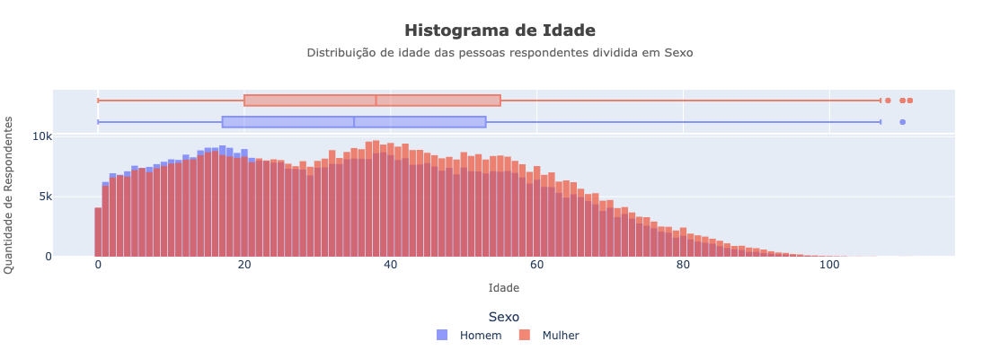

In [12]:
aux = df.select(
    pl.col('idade'),
    pl.col('sexo').replace({1: 'Homem', 2: 'Mulher'})
)

fig = px.histogram(aux, 
                   x="idade", 
                   marginal="box", 
                   color='sexo', 
                   width=800, 
                   height=400
                  )

fig.update_layout(
    title_text=f"<b>Histograma de Idade</b><br /><span style='font-size: 13px; color: #666;'>Distribuição de idade das pessoas respondentes dividida em Sexo</span>",
    xaxis_title_text=f'Idade',
    yaxis_title_text=f'Quantidade de Respondentes',
    barmode='overlay',
    bargap=0.1,
    title_font=dict(size=18, color='#444'),
    title_xanchor = 'center',
    title_x = 0.5,
    title_y = .9,
    legend_title_side='top center',
    legend_title_text=f'Sexo',
    legend=dict(
        orientation="h",
        yanchor="bottom",
        y=-.55,
        xanchor="center",
        x=0.5
    ),
    margin=dict(l=50, r=50, t=100, b=50)
)
    
fig.update_xaxes(
    title_font=dict(size=12, color='#666')
)

fig.update_yaxes(
    title_font=dict(size=12, color='#666')
)

fig.update_traces(
    opacity=0.7,
    hovertemplate="<br>".join([
        "<b>%{x} anos</b>",
        "%{y} respondentes"
    ])
)


fig.show()

In [10]:
fig.write_json('../app/src/assets/g_hist_idade.json')

## Pizza Genero

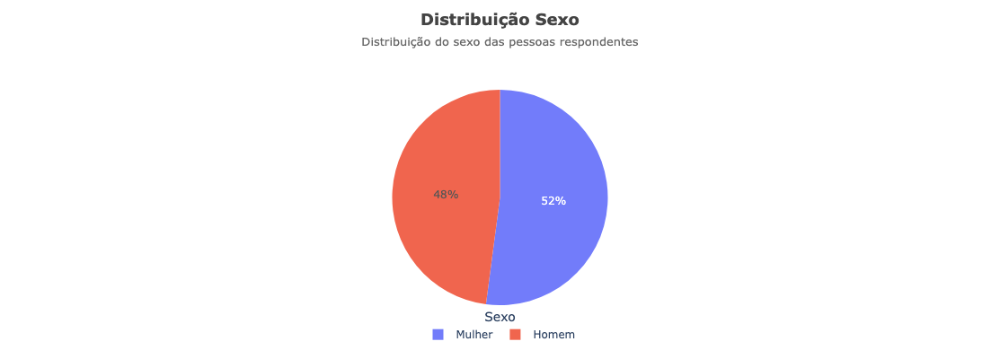

In [23]:
aux = df.select(
    pl.col('sexo').replace({1: 'Homem', 2: 'Mulher'})
).group_by('sexo').agg((pl.count('sexo')/df.shape[0]*100).round(2).alias('prop'))


fig = fig = piegraph(aux, 
               'prop', 
               'sexo', 
               'Distribuição Sexo', 
               f'Distribuição do sexo das pessoas respondentes', 
               'Sexo')

fig.write_json('../app/src/assets/g_pie_sexo.json')
fig.show()


## Cor

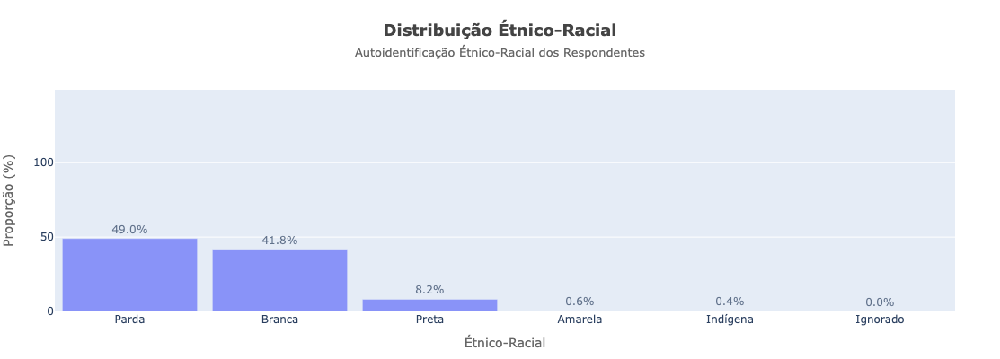

In [24]:
aux = (
    df.select(
        pl.col('uf'),
        pl.col('cor').replace({1: 'Branca', 2: 'Preta', 3: 'Amarela', 4: 'Parda', 5: 'Indígena', 9: 'Ignorado'})
    )
    .group_by('cor')
        .agg((pl.count('uf')/df.shape[0]*100).round(2).alias('prop'))
    .sort('prop', descending=True)
)


fig = bargraph(aux, 
         "cor", 
         "prop", 
         "Distribuição Étnico-Racial", 
         "Autoidentificação Étnico-Racial dos Respondentes",
         "Étnico-Racial",
         "Proporção (%)"
        )

fig.write_json('../app/src/assets/g_bar_etnico.json')
fig.show()

## Escolaridade

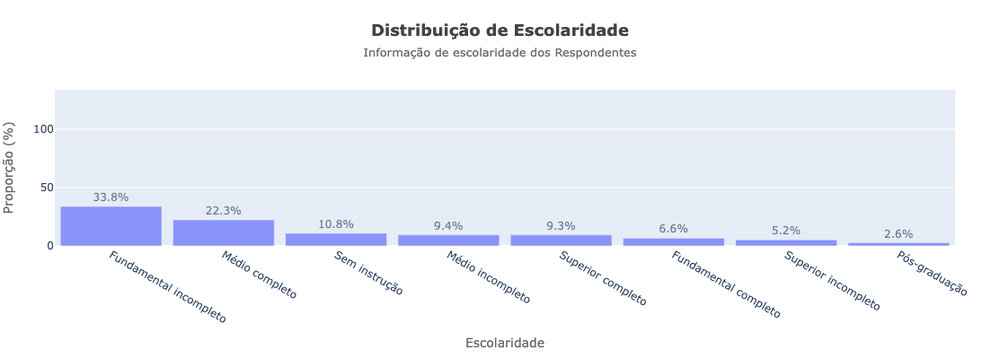

In [25]:
aux = (
    df.select(
        pl.col('uf'),
        pl.col('escolaridade').replace({1: 'Sem instrução', 2: 'Fundamental incompleto', 3: 'Fundamental completo', 4: 'Médio incompleto', 5: 'Médio completo', 6: 'Superior incompleto', 7: 'Superior completo', 8: "Pós-graduação", 9: 'Ignorado'})
    )
    .group_by('escolaridade')
        .agg((pl.count('uf')/df.shape[0]*100).round(2).alias('prop'))
    .sort('prop', descending=True)
)

fig = bargraph(aux, 
         "escolaridade", 
         "prop", 
         "Distribuição de Escolaridade", 
         "Informação de escolaridade dos Respondentes",
         "Escolaridade",
         "Proporção (%)"
        )

fig.write_json('../app/src/assets/g_bar_escola.json')
fig.show()

## Tipo Domicílio

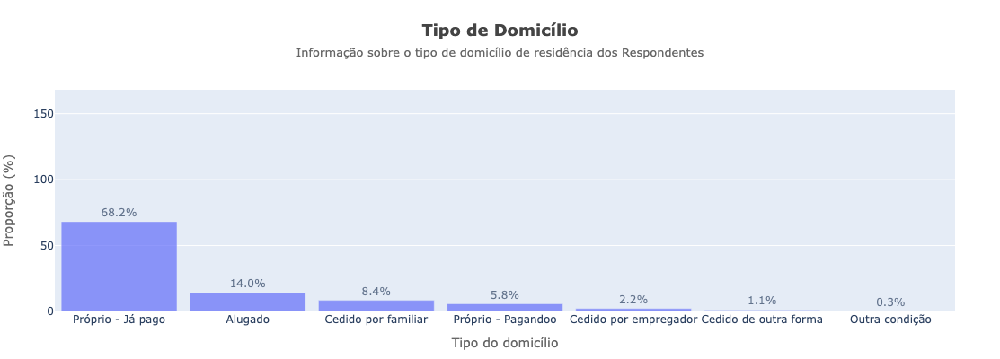

In [26]:
aux = (
    df.select(
        pl.col('uf'),
        pl.col('tipo_domicilio').replace({
            1: "Próprio - Já pago",
            2: "Próprio - Pagandoo",
            3: "Alugado",
            4: "Cedido por empregador",
            5: "Cedido por familiar",
            6: "Cedido de outra forma",
            7: "Outra condição"
        })
    )
    .group_by('tipo_domicilio')
        .agg((pl.count('uf')/df.shape[0]*100).round(2).alias('prop'))
    .sort('prop', descending=True)
)

fig = bargraph(aux, 
         "tipo_domicilio", 
         "prop", 
         "Tipo de Domicílio", 
         "Informação sobre o tipo de domicílio de residência dos Respondentes",
         "Tipo do domicílio",
         "Proporção (%)"
        )

fig.write_json('../app/src/assets/g_bar_domicilio.json')
fig.show()

## Tipo trabalho

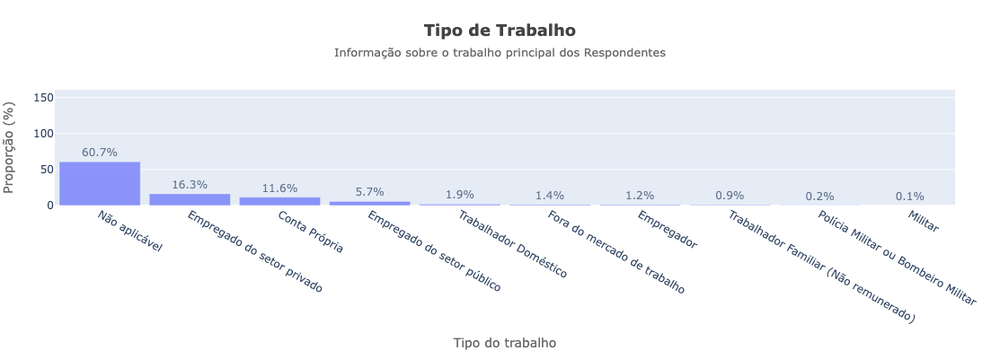

In [27]:
aux = (
    df.fill_null(99).select(
        pl.col('uf'),
        pl.col('tipo_trabalho').replace({
            1: "Trabalhador Doméstico",
            2: "Militar", 
            3: "Polícia Militar ou Bombeiro Militar",
            4: "Empregado do setor privado",
            5: "Empregado do setor público",
            6: "Empregador",
            7: "Conta Própria",
            8: "Trabalhador Familiar (Não remunerado)",
            9: "Fora do mercado de trabalho",
            99: "Não aplicável"
        })
    )
    .group_by('tipo_trabalho')
        .agg((pl.count('uf')/df.shape[0]*100).round(2).alias('prop'))
    .sort('prop', descending=True)
)

fig = bargraph(aux, 
         "tipo_trabalho", 
         "prop", 
         "Tipo de Trabalho", 
         "Informação sobre o trabalho principal dos Respondentes",
         "Tipo do trabalho",
         "Proporção (%)"
        )

fig.write_json('../app/src/assets/g_bar_trabalho.json')
fig.show()

## Fez Restrição de contato

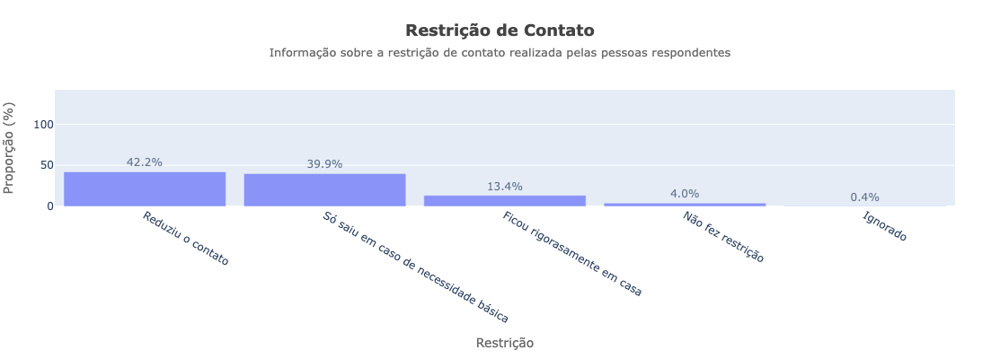

In [28]:
aux = (
    df.fill_null(99).select(
        pl.col('uf'),
        pl.col('restricao_contato').replace({
            1: 'Não fez restrição', 
            2: 'Reduziu o contato', 
            3: 'Só saiu em caso de necessidade básica',
            4: 'Ficou rigorasamente em casa',
            9: 'Ignorado'
        })
    )
    .group_by('restricao_contato')
        .agg((pl.count('uf')/df.shape[0]*100).round(2).alias('prop'))
    .sort('prop', descending=True)
)

fig = bargraph(aux, 
         "restricao_contato", 
         "prop", 
         "Restrição de Contato", 
         "Informação sobre a restrição de contato realizada pelas pessoas respondentes",
         "Restrição",
         "Proporção (%)"
        )

fig.write_json('../app/src/assets/g_bar_restricao.json')
fig.show()

## Atendimento Publico ou Privado

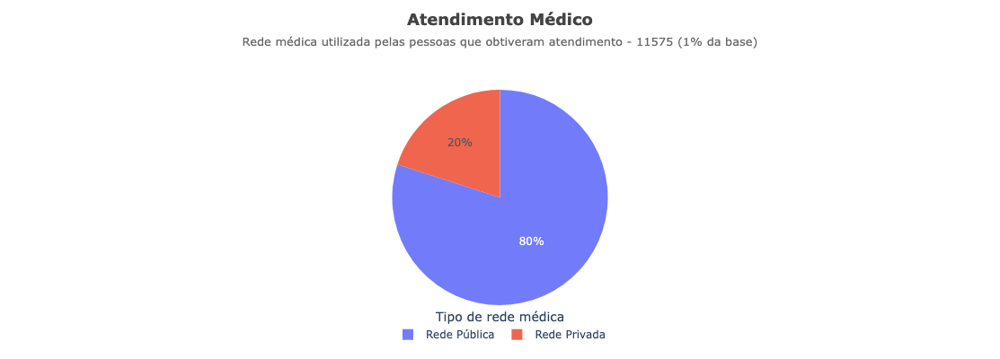

In [29]:
aux_filter = df.filter(pl.col('atendimento_publico') <= 1)

aux = (
    aux_filter
    .select(
        pl.col('uf'),
        pl.col('atendimento_publico').replace({1: 'Rede Pública', 0: 'Rede Privada'})
    )
    .group_by('atendimento_publico')
        .agg((pl.count('uf')/aux_filter.shape[0]*100).round(2).alias('prop'))
    .sort('prop', descending=True)
)

n_atendimento = df.filter(pl.col('atendimento_publico') <= 1).select(pl.count('uf')).item()

fig = piegraph(aux, 
               'prop', 
               'atendimento_publico', 
               'Atendimento Médico', 
               f'Rede médica utilizada pelas pessoas que obtiveram atendimento - {n_atendimento} ({int(n_atendimento/df.shape[0]*100)}% da base)', 
               'Tipo de rede médica')

fig.write_json('../app/src/assets/g_pie_rede.json')
fig.show()

## Resultado Teste

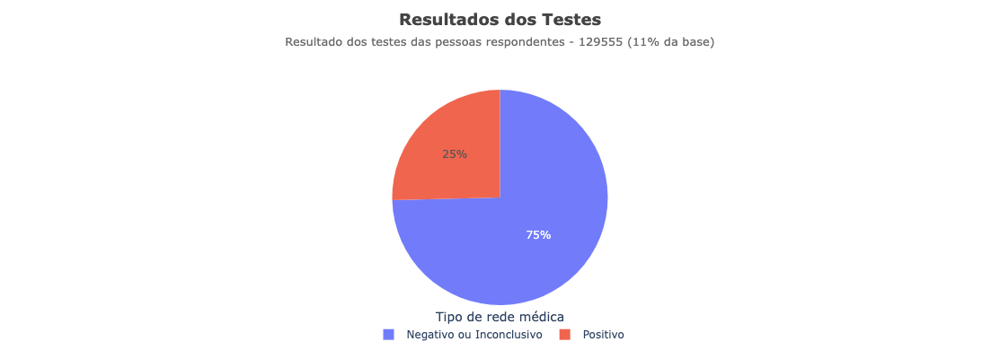

In [30]:
aux_filter = df.filter(pl.col('resultado_positivo') <= 1)

aux = (
    aux_filter
    .select(
        pl.col('uf'),
        pl.col('resultado_positivo').replace({1: 'Positivo', 0: 'Negativo ou Inconclusivo'})
    )
    .group_by('resultado_positivo')
        .agg((pl.count('uf')/aux_filter.shape[0]*100).round(2).alias('prop'))
    .sort('prop', descending=True)
)

n_teste = df.filter(pl.col('resultado_positivo') <= 1).select(pl.count('uf')).item()

fig = piegraph(aux, 
               'prop', 
               'resultado_positivo', 
               'Resultados dos Testes', 
               f'Resultado dos testes das pessoas respondentes - {n_teste} ({int(n_teste/df.shape[0]*100)}% da base)', 
               'Tipo de rede médica')

fig.write_json('../app/src/assets/g_pie_teste.json')
fig.show()

## Sintomas

In [31]:
cols_sintomas = [
    "febre",
    "tosse",
    "dor_garganta",
    "dificuldade_respirar",
    "dor_cabeça",
    "dor_peito",
    "nausea",
    "nariz_entupido",
    "fadiga",
    "dor_olhos",
    "perda_olfato_paladar",
    "dor_muscular",
    "diarreia",
]

aux = (
    df.select(
        pl.col(cols_sintomas).map_elements(lambda x: 0 if x > 1 else x )
    ).mean()
)

aux

febre,tosse,dor_garganta,dificuldade_respirar,dor_cabeça,dor_peito,nausea,nariz_entupido,fadiga,dor_olhos,perda_olfato_paladar,dor_muscular,diarreia
f64,f64,f64,f64,f64,f64,f64,f64,f64,f64,f64,f64,f64
0.007849,0.013377,0.010927,0.004176,0.016498,0.003,0.003444,0.014045,0.007142,0.003194,0.00384,0.00947,0.003743


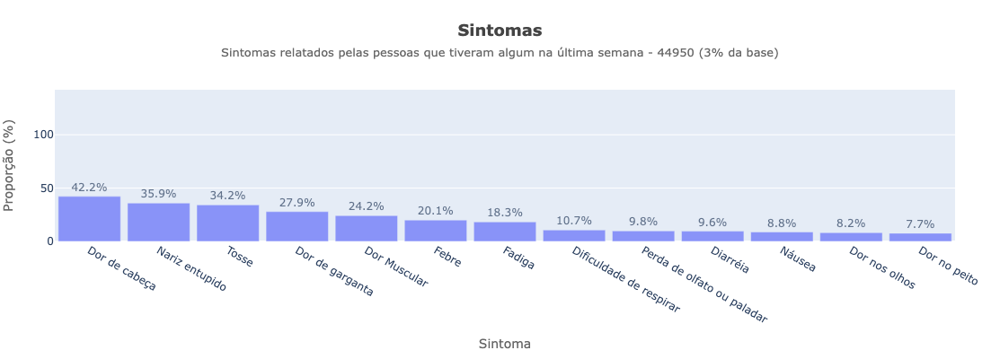

In [32]:
cols_sintomas = [
    "febre",
    "tosse",
    "dor_garganta",
    "dificuldade_respirar",
    "dor_cabeça",
    "dor_peito",
    "nausea",
    "nariz_entupido",
    "fadiga",
    "dor_olhos",
    "perda_olfato_paladar",
    "dor_muscular",
    "diarreia",
]

aux_sintoma = (
    df
    .select(pl.col(cols_sintomas))
    .filter(
        pl.fold( #Função Reducer
            acc=pl.lit(False), 
            function=lambda acc, col: acc | (col <= 1), 
            exprs=pl.col("*")
        )
    )
)

aux = (
    df
    .select(
        pl.col(cols_sintomas).map_elements(lambda x: 0 if x > 1 else x )
    )
    .sum()
    .melt()
    .select(
        pl.col('variable').replace({
            "febre": "Febre",
            "tosse": "Tosse",
            "dor_garganta": "Dor de garganta",
            "dificuldade_respirar": "Dificuldade de respirar",
            "dor_cabeça": "Dor de cabeça",
            "dor_peito": "Dor no peito",
            "nausea": "Náusea",
            "nariz_entupido": "Nariz entupido",
            "fadiga": "Fadiga",
            "dor_olhos": "Dor nos olhos",
            "perda_olfato_paladar": "Perda de olfato ou paladar",
            "dor_muscular": "Dor Muscular",
            "diarreia": "Diarréia"
        }).alias('sintoma'),
        (pl.col('value')/aux_sintoma.shape[0]*100).round(2).alias('prop')
    )
    .sort('prop', descending=True)
)

fig = bargraph(aux, 
         "sintoma", 
         "prop", 
         "Sintomas", 
         f'Sintomas relatados pelas pessoas que tiveram algum na última semana - {aux_sintoma.shape[0]} ({int(aux_sintoma.shape[0]/df.shape[0]*100)}% da base)', 
         "Sintoma",
         "Proporção (%)"
        )

fig.write_json('../app/src/assets/g_bar_sintoma.json')
fig.show()

## Comobirdades

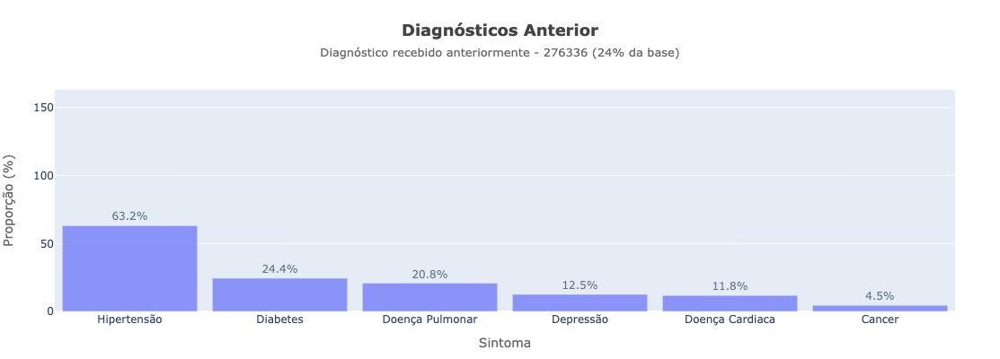

In [33]:
cols_diagnostico = [
    "diagnostico_diabetes",
    "diagnostico_hipertensao",
    "diagnostico_doenca_pulmao",
    "diagnostico_doenca_cardiaca",
    "diagnostico_depressao",
    "diagnostico_cancer"
]

aux_diagnostico = (
    df
    .select(pl.col(cols_diagnostico))
    .filter(
        pl.fold( #Função Reducer
            acc=pl.lit(False), 
            function=lambda acc, col: acc | (col <= 1), 
            exprs=pl.col("*")
        )
    )
)

aux = (
    df
    .select(
        pl.col(cols_diagnostico).map_elements(lambda x: 0 if x > 1 else x )
    )
    .sum()
    .melt()
    .select(
        pl.col('variable').replace({
            "diagnostico_diabetes": "Diabetes",
            "diagnostico_hipertensao": "Hipertensão",
            "diagnostico_doenca_pulmao": "Doença Pulmonar",
            "diagnostico_doenca_cardiaca": "Doença Cardiaca",
            "diagnostico_depressao": "Depressão",
            "diagnostico_cancer": "Cancer"
        }).alias('diagnostico'),
        (pl.col('value')/aux_diagnostico.shape[0]*100).round(2).alias('prop')
    )
    .sort('prop', descending=True)
)

fig = bargraph(aux, 
         "diagnostico", 
         "prop", 
         "Diagnósticos Anterior", 
         f'Diagnóstico recebido anteriormente - {aux_diagnostico.shape[0]} ({int(aux_diagnostico.shape[0]/df.shape[0]*100)}% da base)', 
         "Sintoma",
         "Proporção (%)"
        )

fig.write_json('../app/src/assets/g_bar_diagnostico.json')
fig.show()

# Bivariada

## Hospital Privado

Pessoas que vão ao Hospital Privado tem mais testes positivos?

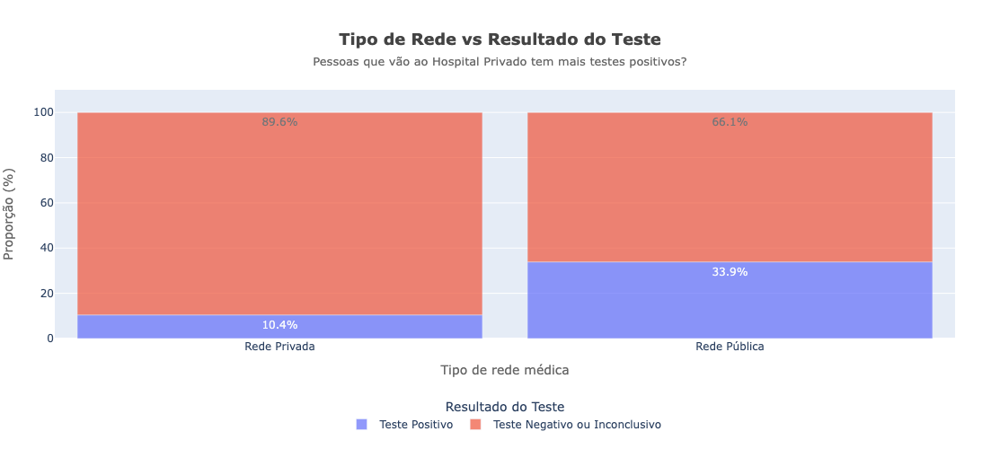

In [34]:
aux_filter = df.filter(
    (pl.col('atendimento_publico') <= 1) & (pl.col('resultado_positivo') <= 1)
)


aux = (
    aux_filter
    .group_by('atendimento_publico')
    .agg(
        (pl.sum('resultado_positivo')/aux_filter.shape[0]).alias('prop_positivo')
    )
    .with_columns(
        (1-pl.col('prop_positivo')).alias('prop_neg')
    )
    .melt(id_vars='atendimento_publico', value_vars=['prop_positivo', 'prop_neg'])
    .select(
        pl.col('atendimento_publico').replace({0: 'Rede Privada', 1:'Rede Pública'}),
        pl.col('variable').replace({"prop_positivo": 'Teste Positivo', "prop_neg": 'Teste Negativo ou Inconclusivo'}),
        (pl.col('value')*100).round(2)
    )
)

fig = bargraph_color(
    aux, 
    "atendimento_publico", 
    "value", 
    "variable",
    "Tipo de Rede vs Resultado do Teste", 
    "Pessoas que vão ao Hospital Privado tem mais testes positivos?",
    "Tipo de rede médica",
    "Proporção (%)",
    "Resultado do Teste"
)

fig.write_json('../app/src/assets/g_cruza_rede_teste.json')
fig.show()

Pessoas que vão ao Hospital Privado tem mais diagnósticos anteriores de doença?

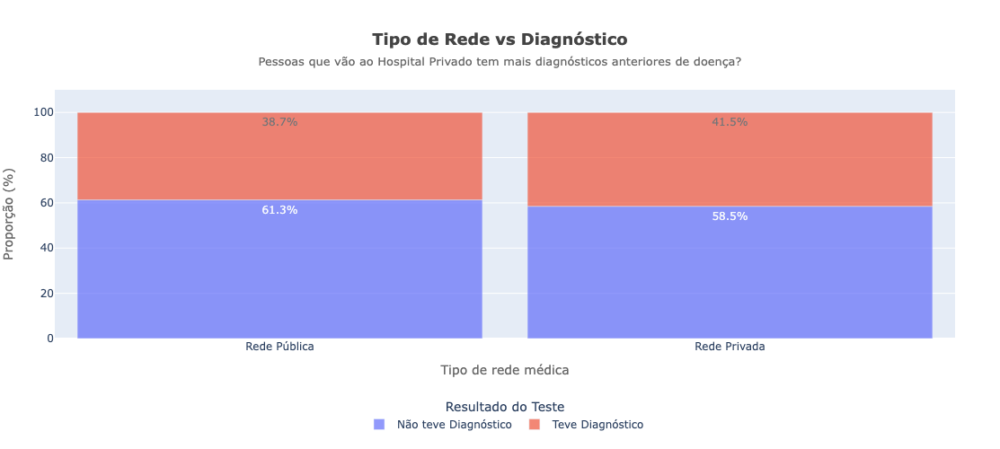

In [35]:
total_pub = df.filter(pl.col('atendimento_publico') == 1).shape[0]
total_priv = df.filter(pl.col('atendimento_publico') == 0).shape[0]

aux_pub = df.with_columns(
    pl.when(
         (pl.col('diagnostico_diabetes') == 1) |
         (pl.col('diagnostico_hipertensao') == 1) |
         (pl.col('diagnostico_doenca_pulmao') == 1) |
         (pl.col('diagnostico_doenca_cardiaca') == 1) |
         (pl.col('diagnostico_depressao') == 1) |
         (pl.col('diagnostico_cancer') == 1)
    ).then(1).otherwise(0).alias('diagnostico')
).filter(
    pl.col('atendimento_publico') == 1   
).group_by(
    pl.col('diagnostico')
).agg(
    ((pl.count('uf') / total_pub)*100).round(2).alias('prop')
).select(
    pl.all(),
    pl.lit('Rede Pública').alias('rede')
)


aux_priv = df.with_columns(
    pl.when(
         (pl.col('diagnostico_diabetes') == 1) |
         (pl.col('diagnostico_hipertensao') == 1) |
         (pl.col('diagnostico_doenca_pulmao') == 1) |
         (pl.col('diagnostico_doenca_cardiaca') == 1) |
         (pl.col('diagnostico_depressao') == 1) |
         (pl.col('diagnostico_cancer') == 1)
    ).then(1).otherwise(0).alias('diagnostico')
).filter(
    pl.col('atendimento_publico') == 0   
).group_by(
    pl.col('diagnostico')
).agg(
    ((pl.count('uf') / total_priv)*100).round(2).alias('prop')
).select(
    pl.all(),
    pl.lit('Rede Privada').alias('rede')
)

aux = pl.concat(
    [aux_pub, aux_priv]
).select(
    pl.col('diagnostico').replace({0: 'Não teve Diagnóstico', 1:'Teve Diagnóstico'}),
    pl.all().exclude('diagnostico')
)

fig = bargraph_color(
    aux, 
    "rede", 
    "prop", 
    "diagnostico",
    "Tipo de Rede vs Diagnóstico", 
    "Pessoas que vão ao Hospital Privado tem mais diagnósticos anteriores de doença?",
    "Tipo de rede médica",
    "Proporção (%)",
    "Resultado do Teste"
)


fig.show()

## Teste Positivo

Pessoas que testaram positivo tem mais diagnósticos anteriores de doença?

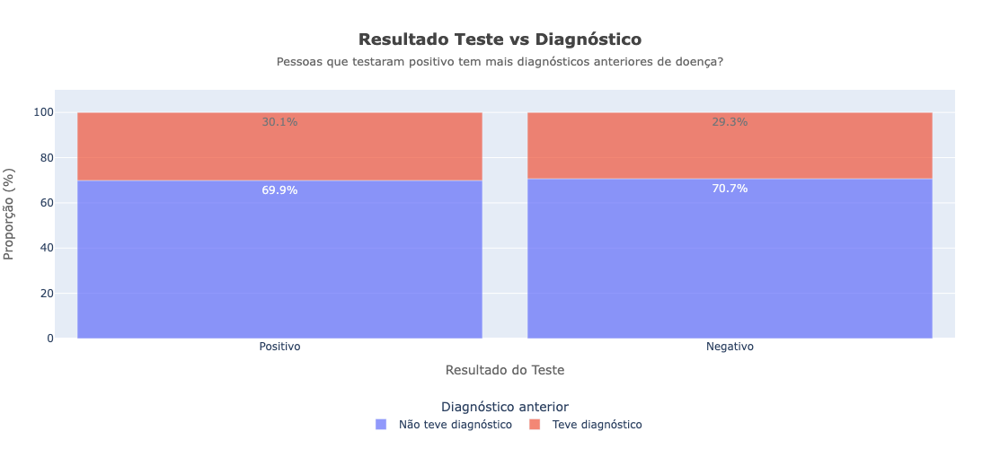

In [36]:
total_pos = df.filter(pl.col('resultado_positivo') == 1).shape[0]
total_neg = df.filter(pl.col('resultado_positivo') == 0).shape[0]

aux_pos = df.with_columns(
    pl.when(
         (pl.col('diagnostico_diabetes') == 1) |
         (pl.col('diagnostico_hipertensao') == 1) |
         (pl.col('diagnostico_doenca_pulmao') == 1) |
         (pl.col('diagnostico_doenca_cardiaca') == 1) |
         (pl.col('diagnostico_depressao') == 1) |
         (pl.col('diagnostico_cancer') == 1)
    ).then(1).otherwise(0).alias('diagnostico')
).filter(
    pl.col('resultado_positivo') == 1   
).group_by(
    pl.col('diagnostico')
).agg(
    ((pl.count('uf') / total_pos)*100).round(2).alias('prop')
).select(
    pl.all(),
    pl.lit('Positivo').alias('Resultado')
)


aux_neg = df.with_columns(
    pl.when(
         (pl.col('diagnostico_diabetes') == 1) |
         (pl.col('diagnostico_hipertensao') == 1) |
         (pl.col('diagnostico_doenca_pulmao') == 1) |
         (pl.col('diagnostico_doenca_cardiaca') == 1) |
         (pl.col('diagnostico_depressao') == 1) |
         (pl.col('diagnostico_cancer') == 1)
    ).then(1).otherwise(0).alias('diagnostico')
).filter(
    pl.col('resultado_positivo') == 0   
).group_by(
    pl.col('diagnostico')
).agg(
    ((pl.count('uf') / total_neg)*100).round(2).alias('prop')
).select(
    pl.all(),
    pl.lit('Negativo').alias('Resultado')
)

aux = pl.concat(
    [aux_pos, aux_neg]
).select(
    pl.col('diagnostico').replace({0: 'Não teve diagnóstico', 1:'Teve diagnóstico'}),
    pl.all().exclude('diagnostico')
)

px.bar(aux, x='Resultado', y='prop', color='diagnostico')

fig = bargraph_color(
    aux, 
    "Resultado", 
    "prop", 
    "diagnostico",
    "Resultado Teste vs Diagnóstico", 
    "Pessoas que testaram positivo tem mais diagnósticos anteriores de doença?",
    "Resultado do Teste",
    "Proporção (%)",
    "Diagnóstico anterior"
)

fig.write_json('../app/src/assets/g_cruza_teste_diagnostico.json')
fig.show()


Pessoas que testaram positivo tiveram mais sintomas?

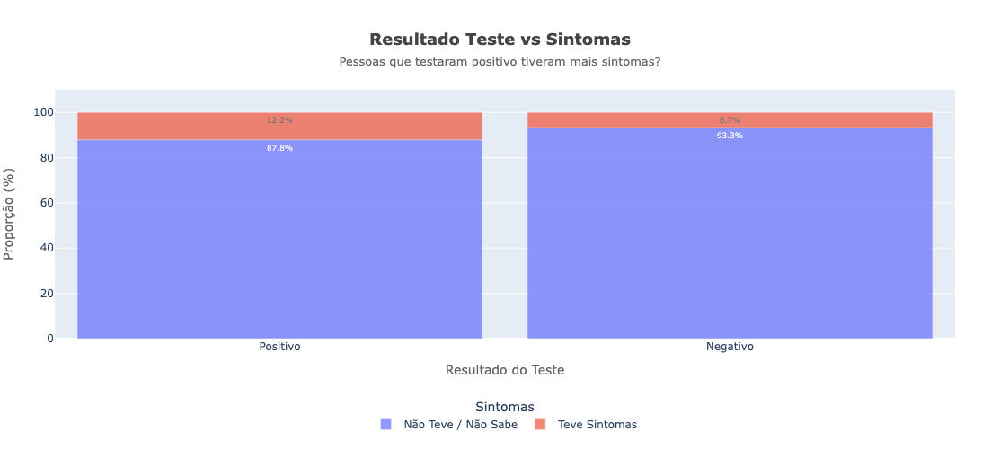

In [124]:
total_pos = df.filter(pl.col('resultado_positivo') == 1).shape[0]
total_neg = df.filter(pl.col('resultado_positivo') == 0).shape[0]

aux_pos = df.with_columns(
    pl.when(
         (pl.col('febre') == 1) |
         (pl.col('tosse') == 1) |
         (pl.col('dor_garganta') == 1) |
         (pl.col('dificuldade_respirar') == 1) |
         (pl.col('dor_cabeça') == 1) |
         (pl.col('dor_peito') == 1) |
         (pl.col('nausea') == 1) |
         (pl.col('nariz_entupido') == 1) |
         (pl.col('fadiga') == 1) |
         (pl.col('dor_olhos') == 1) |
         (pl.col('perda_olfato_paladar') == 1) |
         (pl.col('dor_muscular') == 1) |
         (pl.col('diarreia') == 1)
    ).then(1).otherwise(0).alias('sintomas')
).filter(
    pl.col('resultado_positivo') == 1   
).group_by(
    pl.col('sintomas')
).agg(
    ((pl.count('uf') / total_pos)*100).round(2).alias('prop')
).select(
    pl.all(),
    pl.lit('Positivo').alias('Resultado')
)


aux_neg = df.with_columns(
    pl.when(
         (pl.col('febre') == 1) |
         (pl.col('tosse') == 1) |
         (pl.col('dor_garganta') == 1) |
         (pl.col('dificuldade_respirar') == 1) |
         (pl.col('dor_cabeça') == 1) |
         (pl.col('dor_peito') == 1) |
         (pl.col('nausea') == 1) |
         (pl.col('nariz_entupido') == 1) |
         (pl.col('fadiga') == 1) |
         (pl.col('dor_olhos') == 1) |
         (pl.col('perda_olfato_paladar') == 1) |
         (pl.col('dor_muscular') == 1) |
         (pl.col('diarreia') == 1)
    ).then(1).otherwise(0).alias('sintomas')
).filter(
    pl.col('resultado_positivo') == 0   
).group_by(
    pl.col('sintomas')
).agg(
    ((pl.count('uf') / total_neg)*100).round(2).alias('prop')
).select(
    pl.all(),
    pl.lit('Negativo').alias('Resultado')
)

aux = pl.concat(
    [aux_pos, aux_neg]
).select(
    pl.col('sintomas').replace({1: 'Teve Sintomas', 0: 'Não Teve / Não Sabe'}),
    pl.all().exclude('sintomas')
)



fig = bargraph_color(
    aux, 
    "Resultado", 
    "prop", 
    "sintomas",
    "Resultado Teste vs Sintomas", 
    "Pessoas que testaram positivo tiveram mais sintomas?",
    "Resultado do Teste",
    "Proporção (%)",
    "Sintomas"
)


fig.show()

Dos que declararam ter sintomas, qual a proporção de resultados positivos para cada sintoma

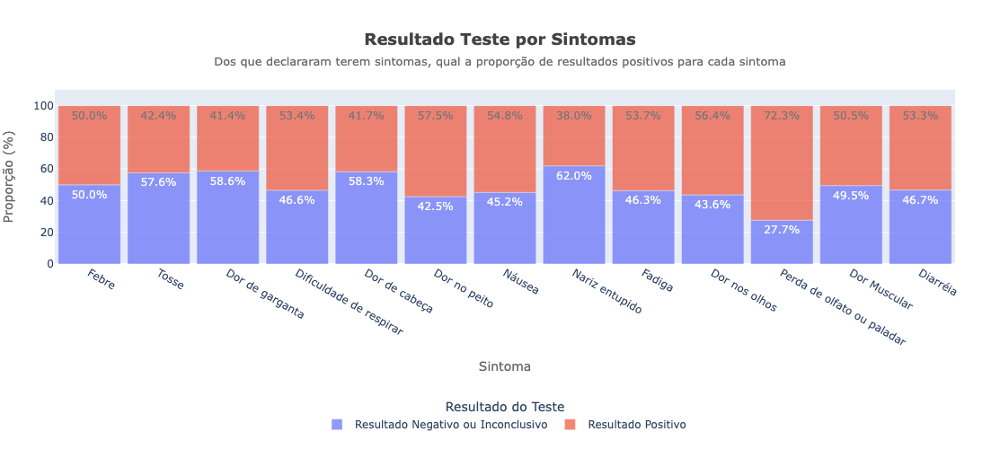

In [37]:
aux_filter = df.filter(pl.col('resultado_positivo') <= 1)

result_df = []
for col in cols_sintomas:
    aux = (aux_filter.select(
        pl.when(pl.col(col) > 1)
            .then(0)
            .otherwise(pl.col(col))
        .alias(col),
        pl.col('resultado_positivo')
    ).filter(pl.col(col) == 1)
    .group_by('resultado_positivo')
    .agg(pl.count(col).alias('contagem'))
    )

    total = aux['contagem'].sum()

    aux = aux.select(
        pl.col('resultado_positivo').replace({1: 'Resultado Positivo', 0: 'Resultado Negativo ou Inconclusivo'}),
        (pl.col('contagem') / total *100).round(2).alias('prop'),
        pl.lit(col).replace({
            "febre": "Febre",
            "tosse": "Tosse",
            "dor_garganta": "Dor de garganta",
            "dificuldade_respirar": "Dificuldade de respirar",
            "dor_cabeça": "Dor de cabeça",
            "dor_peito": "Dor no peito",
            "nausea": "Náusea",
            "nariz_entupido": "Nariz entupido",
            "fadiga": "Fadiga",
            "dor_olhos": "Dor nos olhos",
            "perda_olfato_paladar": "Perda de olfato ou paladar",
            "dor_muscular": "Dor Muscular",
            "diarreia": "Diarréia"
        }).alias('sintoma')
    )


    result_df.append(aux)

aux = pl.concat(result_df)

aux

fig = bargraph_color(
    aux, 
    "sintoma", 
    "prop", 
    "resultado_positivo",
    "Resultado Teste por Sintomas", 
    "Dos que declararam terem sintomas, qual a proporção de resultados positivos para cada sintoma",
    "Sintoma",
    "Proporção (%)",
    "Resultado do Teste",
    -1
)

fig.write_json('../app/src/assets/g_cruza_teste_sintoma.json')
fig.show()

Pessoas que testaram positivo trabalharam mais que o habitual na semana anterior?

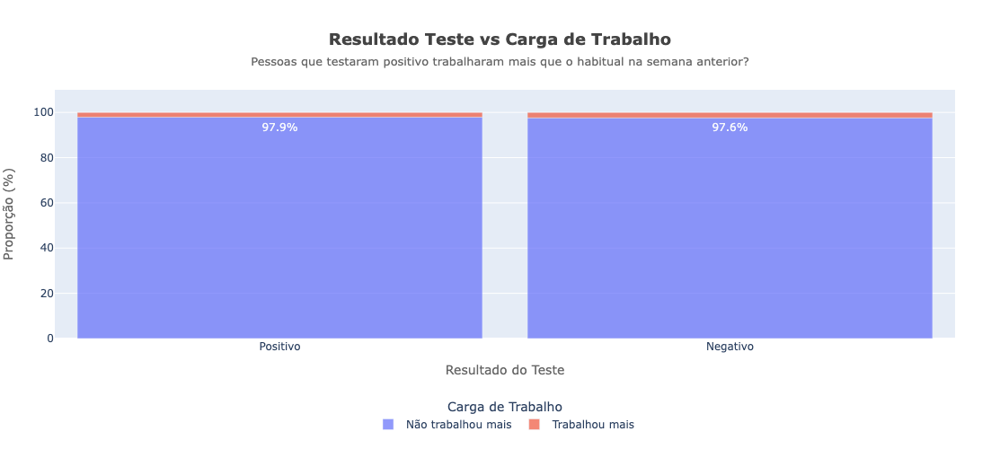

In [139]:
total_pos = df.filter(pl.col('resultado_positivo') == 1).shape[0]
total_neg = df.filter(pl.col('resultado_positivo') == 0).shape[0]

aux_pos = df.with_columns(
    pl.when(
         (pl.col('horas_trabalho_semana_passada') > pl.col('horas_trabalho_normal'))
    ).then(1).otherwise(0).alias('trabalhou_mais')
).filter(
    pl.col('resultado_positivo') == 1   
).group_by(
    pl.col('trabalhou_mais')
).agg(
    ((pl.count('uf') / total_pos)*100).alias('prop')
).select(
    pl.all(),
    pl.lit('Positivo').alias('Resultado')
)


aux_neg = df.with_columns(
    pl.when(
         (pl.col('horas_trabalho_semana_passada') > pl.col('horas_trabalho_normal'))
    ).then(1).otherwise(0).alias('trabalhou_mais')
).filter(
    pl.col('resultado_positivo') == 0   
).group_by(
    pl.col('trabalhou_mais')
).agg(
    ((pl.count('uf') / total_neg)*100).alias('prop')
).select(
    pl.all(),
    pl.lit('Negativo').alias('Resultado')
)

aux = pl.concat(
    [aux_pos, aux_neg]
).select(
    pl.col('trabalhou_mais').replace({1: 'Trabalhou mais', 0: 'Não trabalhou mais'}),
    pl.all().exclude('trabalhou_mais')
)

fig = bargraph_color(
    aux, 
    "Resultado", 
    "prop", 
    "trabalhou_mais",
    "Resultado Teste vs Carga de Trabalho", 
    "Pessoas que testaram positivo trabalharam mais que o habitual na semana anterior?",
    "Resultado do Teste",
    "Proporção (%)",
    "Carga de Trabalho"
)

fig.show()

Pessoas que testaram positivo fizeram restrições de contato?

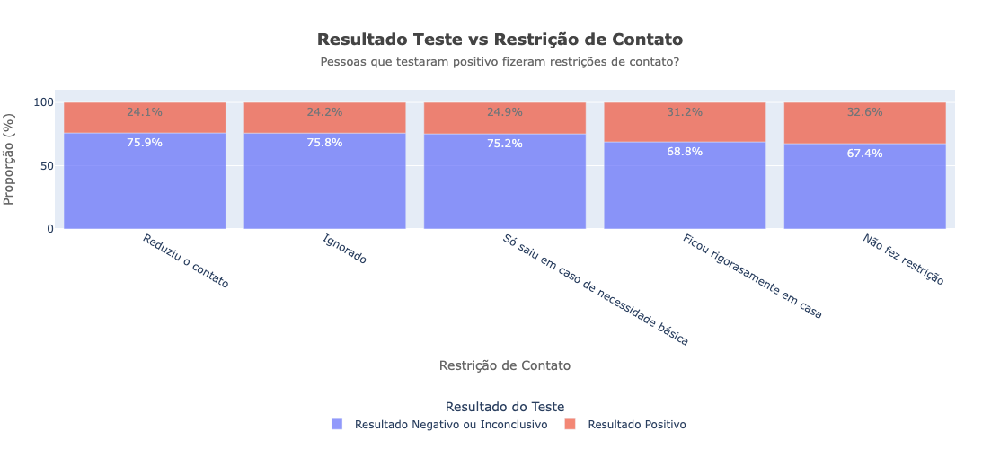

In [38]:
aux_filter = df.filter(pl.col('resultado_positivo') <= 1)

aux = aux_filter.select(
    pl.col('restricao_contato'),
    pl.col('resultado_positivo')
).group_by('restricao_contato').agg(
    pl.mean('resultado_positivo').alias('prop_pos'),
    (1-pl.mean('resultado_positivo')).alias('prop_neg')
).melt(
    id_vars = ['restricao_contato']
).select(
    pl.col('restricao_contato').replace({
        1: 'Não fez restrição', 
        2: 'Reduziu o contato', 
        3: 'Só saiu em caso de necessidade básica',
        4: 'Ficou rigorasamente em casa',
        9: 'Ignorado'
    }),
    pl.col('variable').replace({
        'prop_pos': 'Resultado Positivo',
        'prop_neg': 'Resultado Negativo ou Inconclusivo',
    }).alias('resultado_teste'),
    (pl.col('value')*100).round(2).alias('prop')
).sort('prop', descending=True)

fig = bargraph_color(
    aux, 
    "restricao_contato", 
    "prop", 
    "resultado_teste",
    "Resultado Teste vs Restrição de Contato", 
    "Pessoas que testaram positivo fizeram restrições de contato?",
    "Restrição de Contato",
    "Proporção (%)",
    "Resultado do Teste",
    -1.5
)

fig.write_json('../app/src/assets/g_cruza_teste_restricao.json')
fig.show()

Pessoas que testaram positivo  tem um tipo de trabalho em comum?

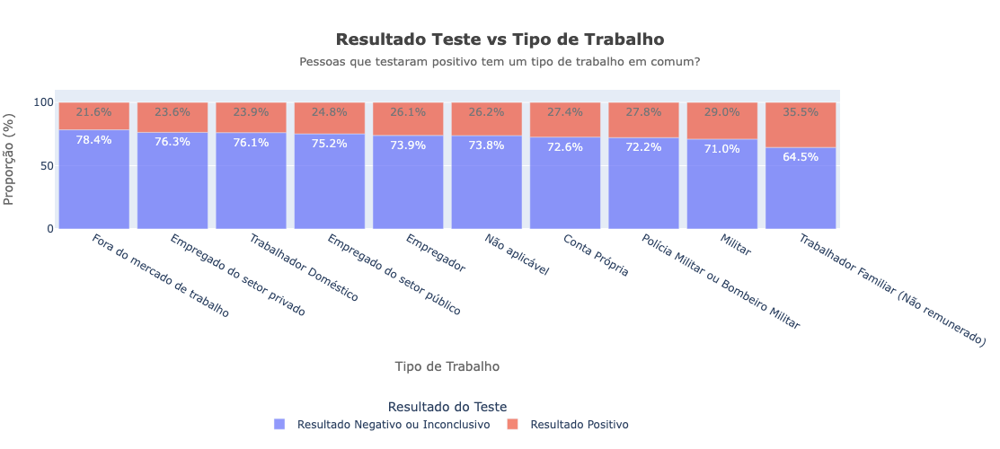

In [164]:
aux_filter = df.filter(pl.col('resultado_positivo') <= 1)

aux = aux_filter.fill_null(99).select(
    pl.col('resultado_positivo'),
    pl.col("tipo_trabalho")
).group_by('tipo_trabalho').agg(
    pl.mean('resultado_positivo').alias('prop_pos'),
    (1 - pl.mean('resultado_positivo')).alias('prop_neg')
).melt(
    id_vars = ['tipo_trabalho']
).select(
    pl.col("tipo_trabalho").replace({
        1: "Trabalhador Doméstico",
        2: "Militar", 
        3: "Polícia Militar ou Bombeiro Militar",
        4: "Empregado do setor privado",
        5: "Empregado do setor público",
        6: "Empregador",
        7: "Conta Própria",
        8: "Trabalhador Familiar (Não remunerado)",
        9: "Fora do mercado de trabalho",
        99: "Não aplicável"
    }),
   pl.col('variable').replace({
        'prop_pos': 'Resultado Positivo',
        'prop_neg': 'Resultado Negativo ou Inconclusivo',
    }).alias('resultado_teste'),
    (pl.col('value')*100).round(2).alias('prop')
).sort('prop', descending=True)


fig = bargraph_color(
    aux, 
    "tipo_trabalho", 
    "prop", 
    "resultado_teste",
    "Resultado Teste vs Tipo de Trabalho", 
    "Pessoas que testaram positivo tem um tipo de trabalho em comum?",
    "Tipo de Trabalho",
    "Proporção (%)",
    "Resultado do Teste",
    -1.5
)

fig.show()